In [2]:
from google.colab import drive
drive.mount('/content/drive')
!cp -av 'drive/My Drive/Colab Notebooks/GANs' '/content'
%cd GANs

Mounted at /content/drive
'drive/My Drive/Colab Notebooks/GANs' -> '/content/GANs'
'drive/My Drive/Colab Notebooks/GANs/MP4_sn.ipynb' -> '/content/GANs/MP4_sn.ipynb'
'drive/My Drive/Colab Notebooks/GANs/download_cat.sh' -> '/content/GANs/download_cat.sh'
'drive/My Drive/Colab Notebooks/GANs/gan' -> '/content/GANs/gan'
'drive/My Drive/Colab Notebooks/GANs/gan/utils.py' -> '/content/GANs/gan/utils.py'
'drive/My Drive/Colab Notebooks/GANs/gan/.ipynb_checkpoints' -> '/content/GANs/gan/.ipynb_checkpoints'
'drive/My Drive/Colab Notebooks/GANs/gan/.ipynb_checkpoints/train-checkpoint.py' -> '/content/GANs/gan/.ipynb_checkpoints/train-checkpoint.py'
'drive/My Drive/Colab Notebooks/GANs/gan/.ipynb_checkpoints/utils-checkpoint.py' -> '/content/GANs/gan/.ipynb_checkpoints/utils-checkpoint.py'
'drive/My Drive/Colab Notebooks/GANs/gan/__pycache__' -> '/content/GANs/gan/__pycache__'
'drive/My Drive/Colab Notebooks/GANs/gan/__pycache__/utils.cpython-38.pyc' -> '/content/GANs/gan/__pycache__/utils.cpyt

In [ ]:
# !sh download_cat.sh

# Generative Adversarial Networks

For this part of the assignment you implement two different types of generative adversarial networks. We will train the networks on a dataset of cat face images.

In [ ]:
import torch
from torch.utils.data import DataLoader
from torchvision import transforms
from torchvision.datasets import ImageFolder
import matplotlib.pyplot as plt
import numpy as np

%matplotlib inline
plt.rcParams['figure.figsize'] = (10.0, 8.0) # set default size of plots
plt.rcParams['image.interpolation'] = 'nearest'
plt.rcParams['image.cmap'] = 'gray'

%load_ext autoreload
%autoreload 2

In [ ]:
from gan.train import train

In [ ]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "gpu")

# GAN loss functions

In this assignment you will implement two different types of GAN cost functions. You will first implement the loss from the [original GAN paper](https://arxiv.org/pdf/1406.2661.pdf). You will also implement the loss from [LS-GAN](https://arxiv.org/abs/1611.04076). 

### GAN loss

**TODO:** Implement the `discriminator_loss` and `generator_loss` functions in `gan/losses.py`.

The generator loss is given by:
$$\ell_G  =  -\mathbb{E}_{z \sim p(z)}\left[\log D(G(z))\right]$$
and the discriminator loss is:
$$ \ell_D = -\mathbb{E}_{x \sim p_\text{data}}\left[\log D(x)\right] - \mathbb{E}_{z \sim p(z)}\left[\log \left(1-D(G(z))\right)\right]$$
Note that these are negated from the equations presented earlier as we will be *minimizing* these losses.

**HINTS**: You should use the `torch.nn.functional.binary_cross_entropy_with_logits` function to compute the binary cross entropy loss since it is more numerically stable than using a softmax followed by BCE loss. The BCE loss is needed to compute the log probability of the true label given the logits output from the discriminator. Given a score $s\in\mathbb{R}$ and a label $y\in\{0, 1\}$, the binary cross entropy loss is

$$ bce(s, y) = -y * \log(s) - (1 - y) * \log(1 - s) $$


Instead of computing the expectation of $\log D(G(z))$, $\log D(x)$ and $\log \left(1-D(G(z))\right)$, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing.

In [ ]:
from gan.losses import discriminator_loss, generator_loss

### Least Squares GAN loss

**TODO:** Implement the `ls_discriminator_loss` and `ls_generator_loss` functions in `gan/losses.py`.

We'll now look at [Least Squares GAN](https://arxiv.org/abs/1611.04076), a newer, more stable alernative to the original GAN loss function. For this part, all we have to do is change the loss function and retrain the model. We'll implement equation (9) in the paper, with the generator loss:
$$\ell_G  =  \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[\left(D(G(z))-1\right)^2\right]$$
and the discriminator loss:
$$ \ell_D = \frac{1}{2}\mathbb{E}_{x \sim p_\text{data}}\left[\left(D(x)-1\right)^2\right] + \frac{1}{2}\mathbb{E}_{z \sim p(z)}\left[ \left(D(G(z))\right)^2\right]$$


**HINTS**: Instead of computing the expectation, we will be averaging over elements of the minibatch, so make sure to combine the loss by averaging instead of summing. When plugging in for $D(x)$ and $D(G(z))$ use the direct output from the discriminator (`scores_real` and `scores_fake`).

In [ ]:
from gan.losses import ls_discriminator_loss, ls_generator_loss

# GAN model architecture

**TODO:** Implement the `Discriminator` and `Generator` networks in `gan/models.py`.

We recommend the following architectures which are inspired by [DCGAN](https://arxiv.org/pdf/1511.06434.pdf):

**Discriminator:**

- convolutional layer with in_channels=3, out_channels=128, kernel=4, stride=2
- convolutional layer with in_channels=128, out_channels=256, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=256, out_channels=512, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=512, out_channels=1024, kernel=4, stride=2
- batch norm
- convolutional layer with in_channels=1024, out_channels=1, kernel=4, stride=1

Use padding = 1 (not 0) for all the convolutional layers.

Instead of Relu we LeakyReLu throughout the discriminator (we use a negative slope value of 0.2). You can use simply use relu as well.

The output of your discriminator should be a single value score corresponding to each input sample. See `torch.nn.LeakyReLU`.


**Generator:**

**Note:** In the generator, you will need to use transposed convolution (sometimes known as fractionally-strided convolution or deconvolution). This function is implemented in pytorch as `torch.nn.ConvTranspose2d`.

- transpose convolution with in_channels=NOISE_DIM, out_channels=1024, kernel=4, stride=1
- batch norm
- transpose convolution with in_channels=1024, out_channels=512, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=512, out_channels=256, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=256, out_channels=128, kernel=4, stride=2
- batch norm
- transpose convolution with in_channels=128, out_channels=3, kernel=4, stride=2

The output of the final layer of the generator network should have a `tanh` nonlinearity to output values between -1 and 1. The output should be a 3x64x64 tensor for each sample (equal dimensions to the images from the dataset).





In [ ]:
from gan.models import Discriminator, Generator, Discriminator_sn

# Data loading

The cat images we provide are RGB images with a resolution of 64x64. In order to prevent our discriminator from overfitting, we will need to perform some data augmentation.

**TODO:** Implement data augmentation by adding new transforms to the cell below. At the minimum, you should have a RandomCrop and a ColorJitter, but we encourage you to experiment with different augmentations to see how the performance of the GAN changes. See https://pytorch.org/vision/stable/transforms.html.


In [ ]:
batch_size = 32
imsize = 64
cat_root = './cats'

cat_train = ImageFolder(root=cat_root, transform=transforms.Compose([
  transforms.ToTensor(),
    
  # Example use of RandomCrop:
  transforms.Resize(int(1.15 * imsize)),
  transforms.RandomCrop(imsize),
]))

cat_loader_train = DataLoader(cat_train, batch_size=batch_size, drop_last=True)

### Visualize dataset

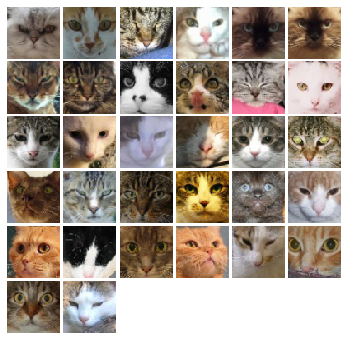

In [ ]:
from gan.utils import show_images

imgs = cat_loader_train.__iter__().next()[0].numpy().squeeze()
show_images(imgs, color=True)

# Training 


**TODO:** Fill in the training loop in `gan/train.py`.

In [ ]:
NOISE_DIM = 100
NUM_EPOCHS = 50
learning_rate = 0.001

### Train GAN

In [ ]:
D = Discriminator_sn().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [ ]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1
Iter: 0, D: 1.395, G:5.295


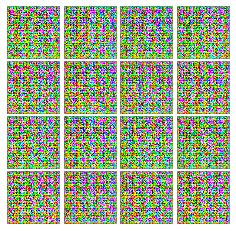


Iter: 250, D: 1.286, G:0.968


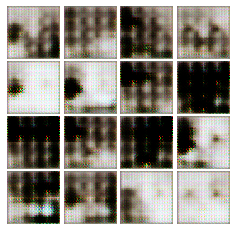


EPOCH:  2
Iter: 500, D: 1.395, G:0.8463


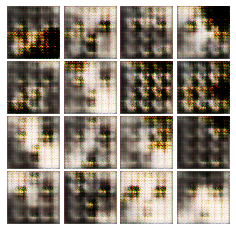


Iter: 750, D: 1.303, G:0.8354


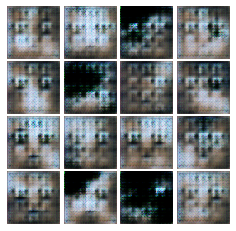


EPOCH:  3
Iter: 1000, D: 1.346, G:0.7561


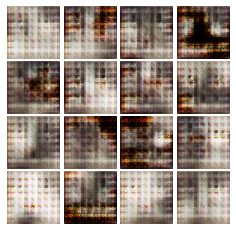


Iter: 1250, D: 1.213, G:0.874


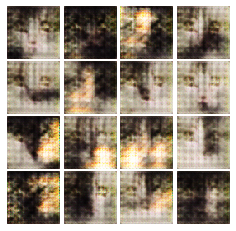


EPOCH:  4
Iter: 1500, D: 1.164, G:1.098


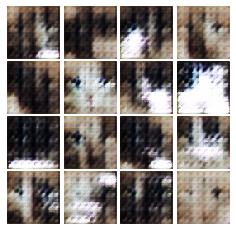


Iter: 1750, D: 1.492, G:1.358


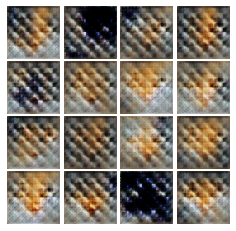


EPOCH:  5
Iter: 2000, D: 1.345, G:0.9859


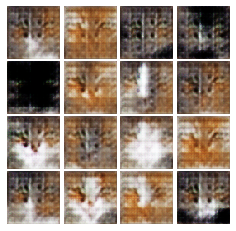


Iter: 2250, D: 1.406, G:0.783


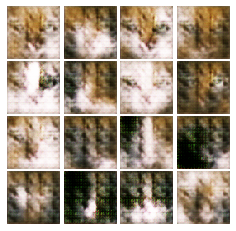


EPOCH:  6
Iter: 2500, D: 1.261, G:0.881


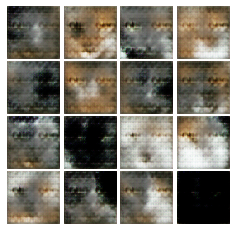


Iter: 2750, D: 1.627, G:0.6735


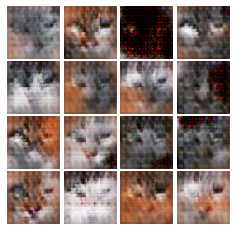


EPOCH:  7
Iter: 3000, D: 1.22, G:1.038


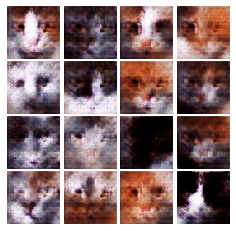


Iter: 3250, D: 1.382, G:0.9207


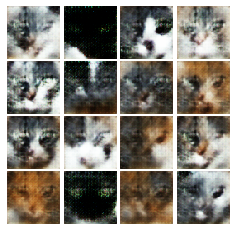


EPOCH:  8
Iter: 3500, D: 1.44, G:0.7748


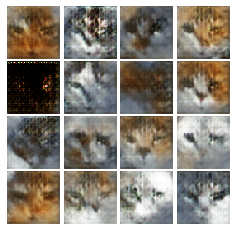


Iter: 3750, D: 1.107, G:0.9482


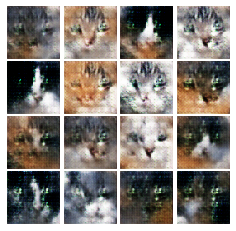


EPOCH:  9
Iter: 4000, D: 1.344, G:1.021


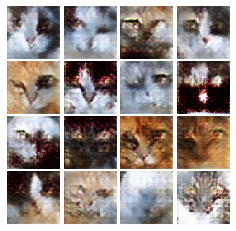


Iter: 4250, D: 1.301, G:1.008


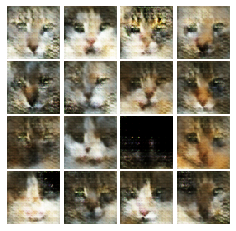


EPOCH:  10
Iter: 4500, D: 1.227, G:0.9966


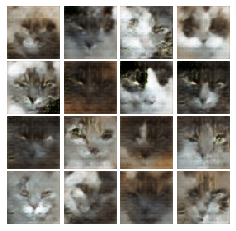


Iter: 4750, D: 1.323, G:0.9862


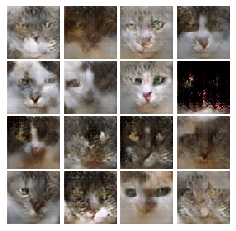


EPOCH:  11
Iter: 5000, D: 1.369, G:1.056


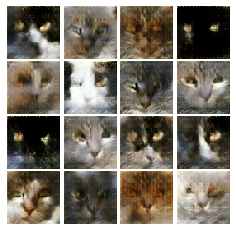


Iter: 5250, D: 1.101, G:0.9786


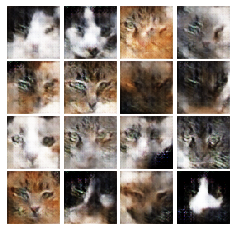


EPOCH:  12
Iter: 5500, D: 1.402, G:0.8191


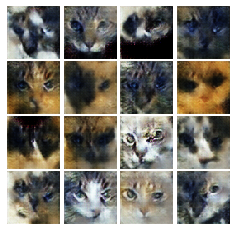


Iter: 5750, D: 1.309, G:0.9515


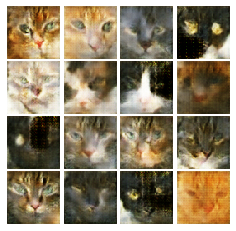


EPOCH:  13
Iter: 6000, D: 1.307, G:1.063


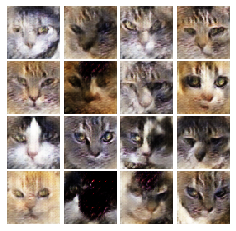


Iter: 6250, D: 1.404, G:1.087


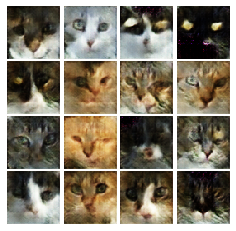


EPOCH:  14
Iter: 6500, D: 1.251, G:0.8608


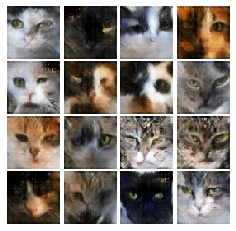


Iter: 6750, D: 1.357, G:0.8349


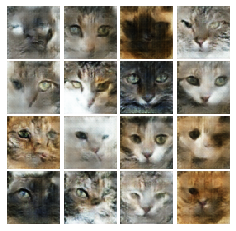


EPOCH:  15
Iter: 7000, D: 1.431, G:0.9834


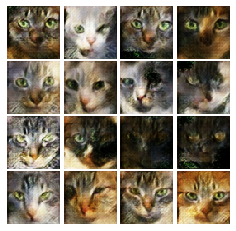


Iter: 7250, D: 1.302, G:0.835


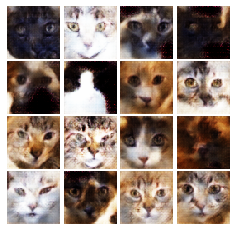


EPOCH:  16
Iter: 7500, D: 1.429, G:0.7791


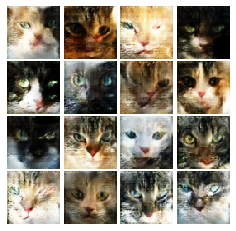


Iter: 7750, D: 1.389, G:0.8373


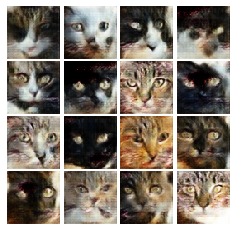


EPOCH:  17
Iter: 8000, D: 1.397, G:0.7804


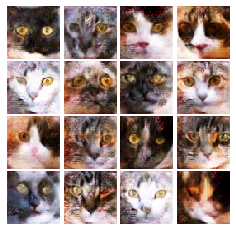


Iter: 8250, D: 1.385, G:0.7742


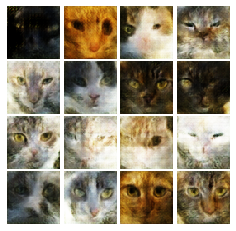


EPOCH:  18
Iter: 8500, D: 1.393, G:0.84


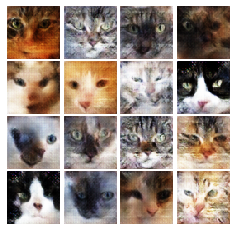


Iter: 8750, D: 1.329, G:0.9634


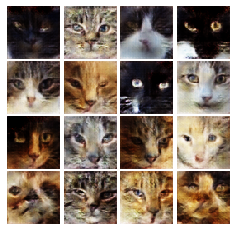


EPOCH:  19
Iter: 9000, D: 1.301, G:0.9102


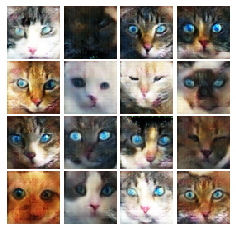


Iter: 9250, D: 1.407, G:0.6369


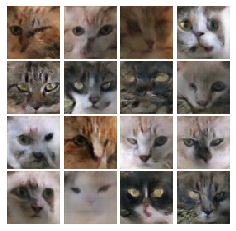


EPOCH:  20
Iter: 9500, D: 1.323, G:0.8253


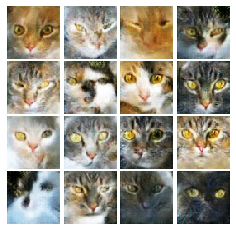


Iter: 9750, D: 1.352, G:0.7667


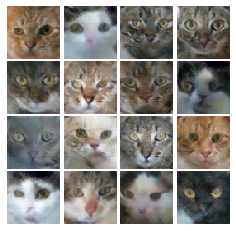


EPOCH:  21
Iter: 10000, D: 1.428, G:0.8997


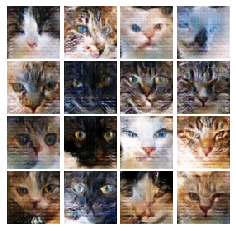


Iter: 10250, D: 1.254, G:0.803


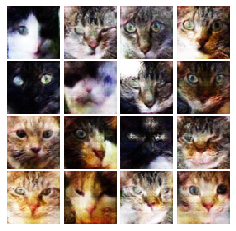


EPOCH:  22
Iter: 10500, D: 1.401, G:0.8175


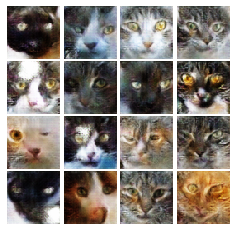


Iter: 10750, D: 1.26, G:0.7502


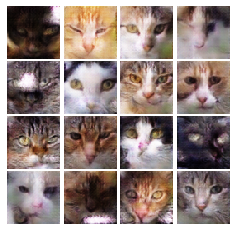


EPOCH:  23
Iter: 11000, D: 1.372, G:0.8883


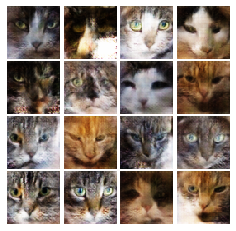


Iter: 11250, D: 1.37, G:0.839


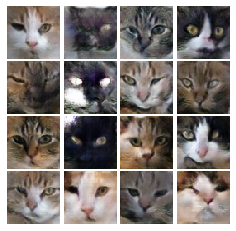


EPOCH:  24
Iter: 11500, D: 1.363, G:0.8165


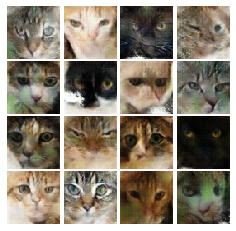


Iter: 11750, D: 1.388, G:0.8447


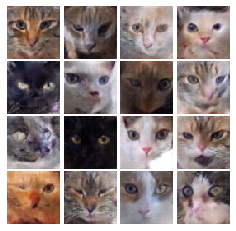


EPOCH:  25
Iter: 12000, D: 1.317, G:0.8782


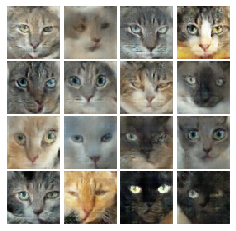


Iter: 12250, D: 1.411, G:0.7451


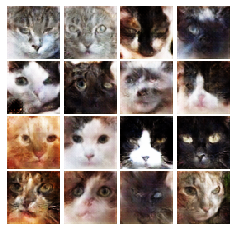


EPOCH:  26
Iter: 12500, D: 1.321, G:0.8089


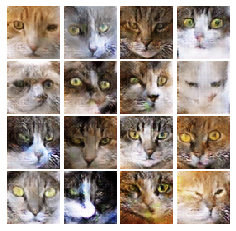


Iter: 12750, D: 1.338, G:0.7207


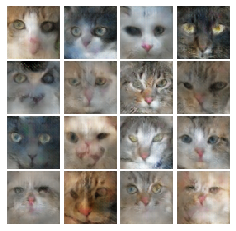


EPOCH:  27
Iter: 13000, D: 1.322, G:0.7628


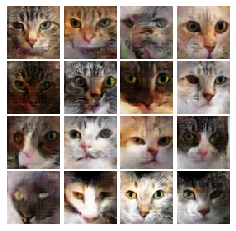


Iter: 13250, D: 1.334, G:0.792


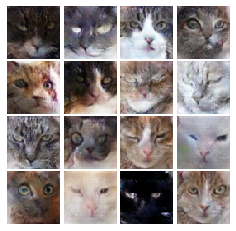


EPOCH:  28
Iter: 13500, D: 1.345, G:0.8582


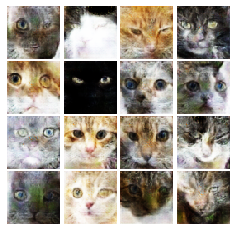


Iter: 13750, D: 1.248, G:0.8246


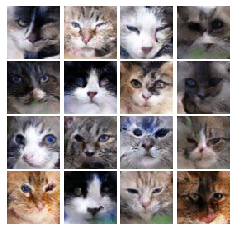


EPOCH:  29
Iter: 14000, D: 1.256, G:0.7098


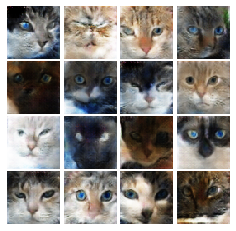


Iter: 14250, D: 1.255, G:0.7931


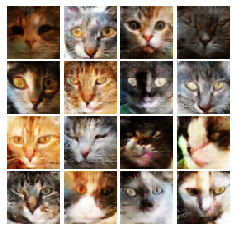


EPOCH:  30
Iter: 14500, D: 1.324, G:0.884


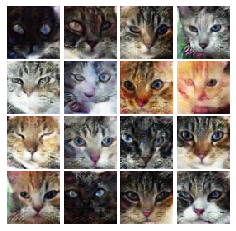


Iter: 14750, D: 1.458, G:0.8529


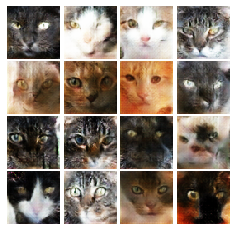


EPOCH:  31
Iter: 15000, D: 1.42, G:0.6783


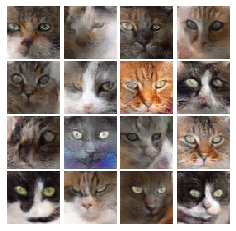


Iter: 15250, D: 1.268, G:0.7369


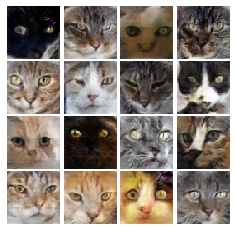


EPOCH:  32
Iter: 15500, D: 1.366, G:0.6986


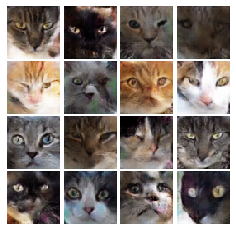


EPOCH:  33
Iter: 15750, D: 1.389, G:0.975


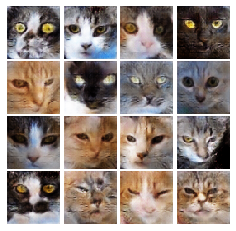


Iter: 16000, D: 1.342, G:0.866


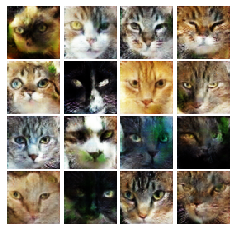


EPOCH:  34
Iter: 16250, D: 1.186, G:0.7986


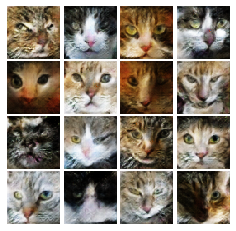


Iter: 16500, D: 1.273, G:0.8605


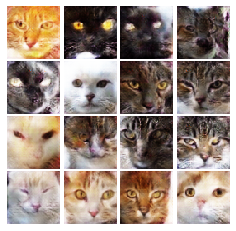


EPOCH:  35
Iter: 16750, D: 1.293, G:0.7338


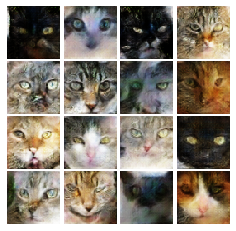


Iter: 17000, D: 1.25, G:0.857


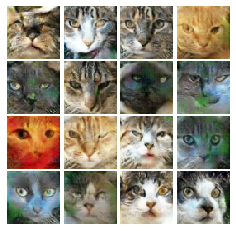


EPOCH:  36
Iter: 17250, D: 1.236, G:0.7079


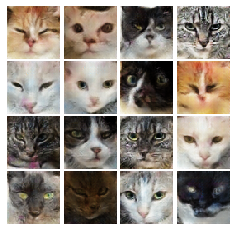


Iter: 17500, D: 1.203, G:0.9365


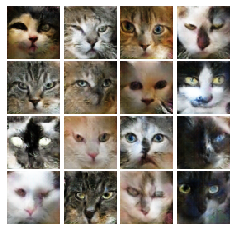


EPOCH:  37
Iter: 17750, D: 1.275, G:0.8712


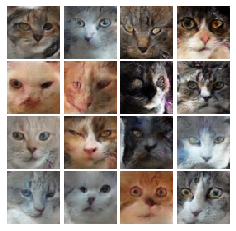


Iter: 18000, D: 1.321, G:0.7106


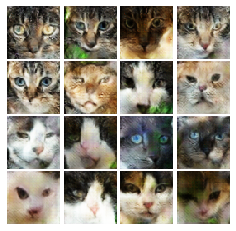


EPOCH:  38
Iter: 18250, D: 1.343, G:0.84


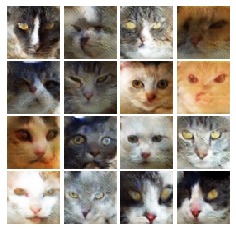


Iter: 18500, D: 1.282, G:0.8464


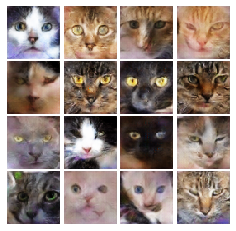


EPOCH:  39
Iter: 18750, D: 1.361, G:1.153


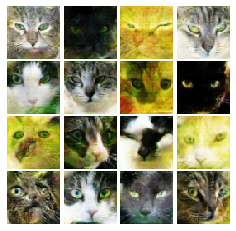


Iter: 19000, D: 1.193, G:0.8689


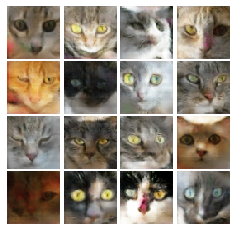


EPOCH:  40
Iter: 19250, D: 1.342, G:0.8616


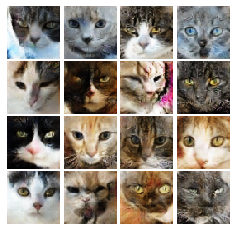


Iter: 19500, D: 1.228, G:0.8146


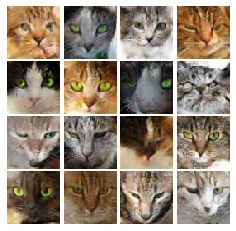


EPOCH:  41
Iter: 19750, D: 1.233, G:0.811


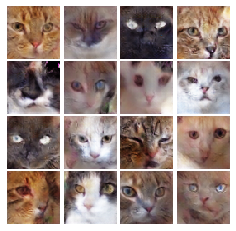


Iter: 20000, D: 1.312, G:0.9785


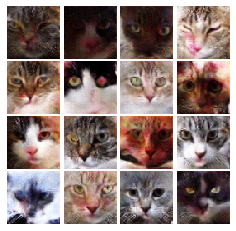


EPOCH:  42
Iter: 20250, D: 1.165, G:0.8427


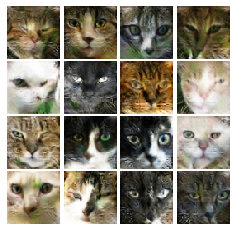


Iter: 20500, D: 1.303, G:0.7979


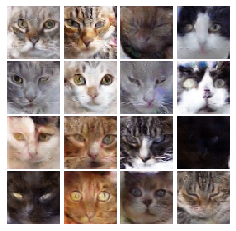


EPOCH:  43
Iter: 20750, D: 1.252, G:0.9529


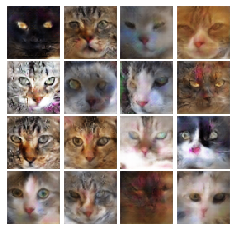


Iter: 21000, D: 1.341, G:0.8162


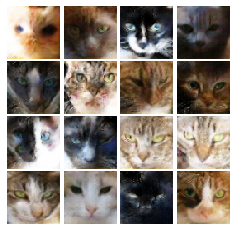


EPOCH:  44
Iter: 21250, D: 1.199, G:0.9758


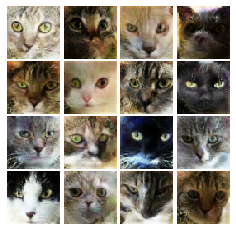


Iter: 21500, D: 1.377, G:1.035


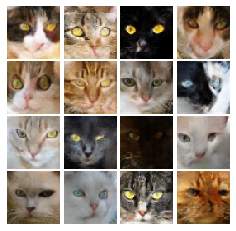


EPOCH:  45
Iter: 21750, D: 1.339, G:0.7667


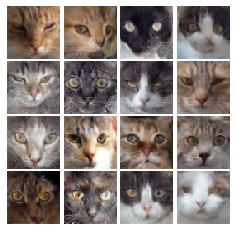


Iter: 22000, D: 1.275, G:0.9514


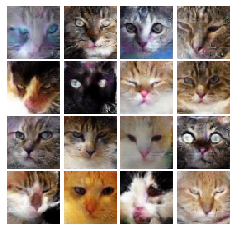


EPOCH:  46
Iter: 22250, D: 1.183, G:0.8834


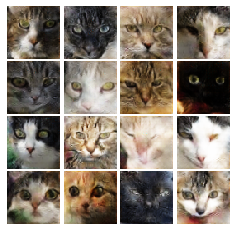


Iter: 22500, D: 1.265, G:1.004


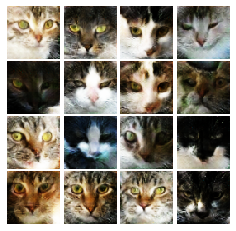


EPOCH:  47
Iter: 22750, D: 1.254, G:1.057


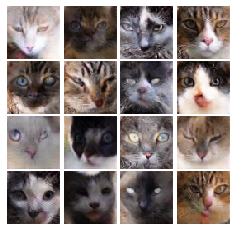


Iter: 23000, D: 1.307, G:0.9753


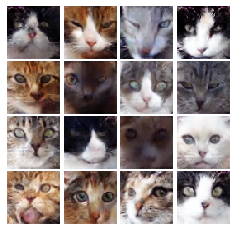


EPOCH:  48
Iter: 23250, D: 1.088, G:0.9783


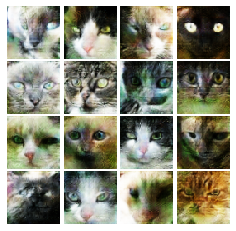


Iter: 23500, D: 1.34, G:0.9985


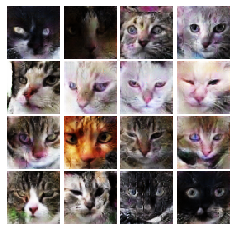


EPOCH:  49
Iter: 23750, D: 1.137, G:1.051


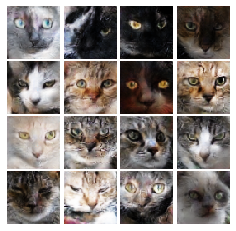


Iter: 24000, D: 1.215, G:1.018


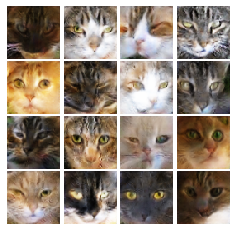


EPOCH:  50
Iter: 24250, D: 1.244, G:1.026


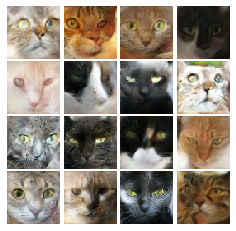


Iter: 24500, D: 1.241, G:1.004


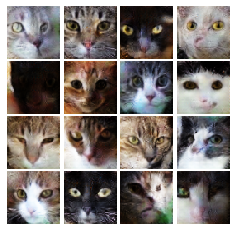

In [ ]:
# original gan
#  change the train() method a little bit to fit the input dimension. noise_size
train(D, G, D_optimizer, G_optimizer, discriminator_loss, 
          generator_loss, num_epochs=NUM_EPOCHS, show_every=250,
          batch_size=batch_size, train_loader=cat_loader_train, device=device)


### Train LS-GAN

In [ ]:
D = Discriminator().to(device)
G = Generator(noise_dim=NOISE_DIM).to(device)

In [ ]:
D_optimizer = torch.optim.Adam(D.parameters(), lr=learning_rate, betas = (0.5, 0.999))
G_optimizer = torch.optim.Adam(G.parameters(), lr=learning_rate, betas = (0.5, 0.999))

EPOCH:  1
Iter: 0, D: 0.438, G:114.6


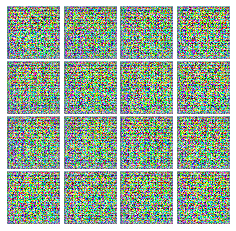


Iter: 250, D: 0.7109, G:0.4707


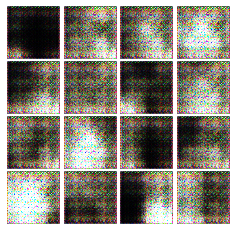


EPOCH:  2
Iter: 500, D: 0.3447, G:0.421


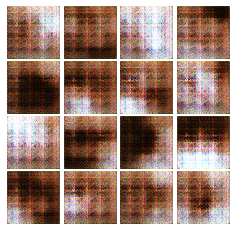


Iter: 750, D: 0.3172, G:0.0834


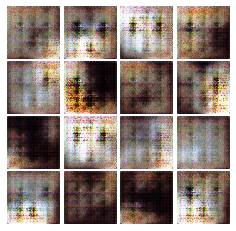


EPOCH:  3
Iter: 1000, D: 0.5681, G:0.9675


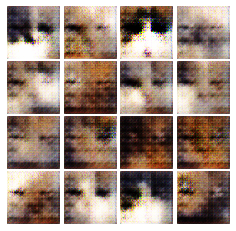


Iter: 1250, D: 0.2292, G:0.317


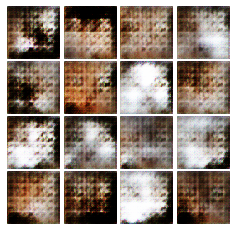


EPOCH:  4
Iter: 1500, D: 0.3124, G:0.2515


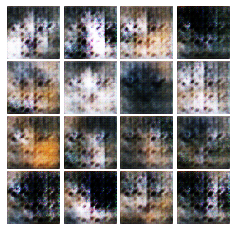


Iter: 1750, D: 0.2881, G:0.6068


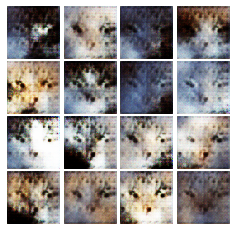


EPOCH:  5
Iter: 2000, D: 0.2778, G:0.1806


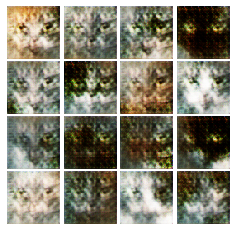


Iter: 2250, D: 0.2392, G:0.4143


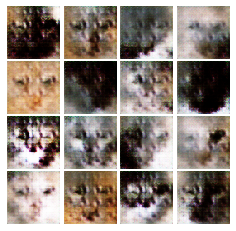


EPOCH:  6
Iter: 2500, D: 0.2208, G:0.2103


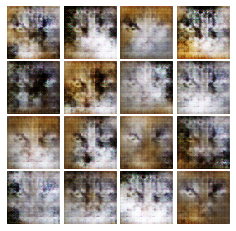


Iter: 2750, D: 0.232, G:0.3408


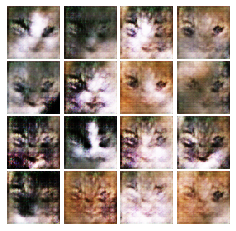


EPOCH:  7
Iter: 3000, D: 0.198, G:0.3703


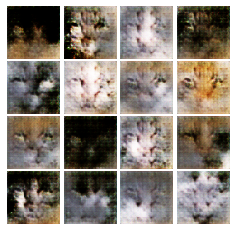


Iter: 3250, D: 0.1973, G:0.347


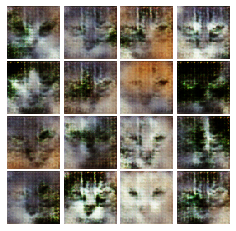


EPOCH:  8
Iter: 3500, D: 0.2851, G:0.2855


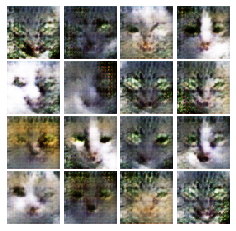


Iter: 3750, D: 0.1885, G:0.4831


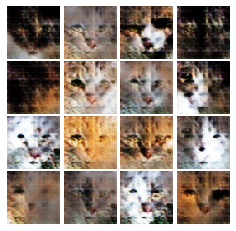


EPOCH:  9
Iter: 4000, D: 0.255, G:0.5124


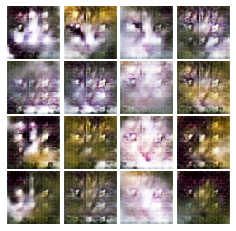


Iter: 4250, D: 0.2509, G:0.5324


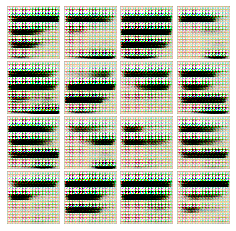


EPOCH:  10
Iter: 4500, D: 0.2124, G:0.1427


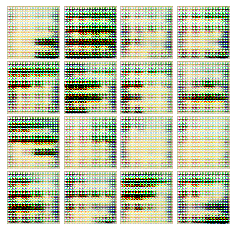


Iter: 4750, D: 0.1667, G:0.3362


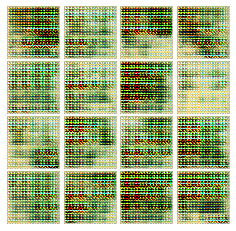


EPOCH:  11
Iter: 5000, D: 0.1004, G:0.2334


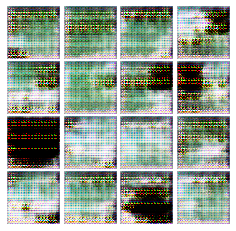


Iter: 5250, D: 0.2365, G:0.3077


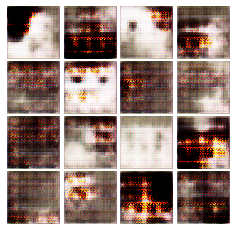


EPOCH:  12
Iter: 5500, D: 0.2254, G:0.1906


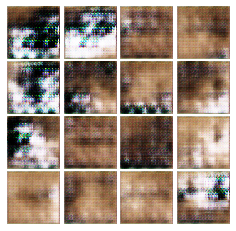


Iter: 5750, D: 0.2441, G:0.2469


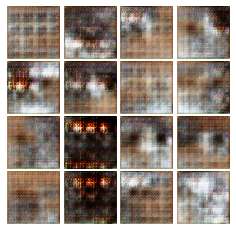


EPOCH:  13
Iter: 6000, D: 0.262, G:0.204


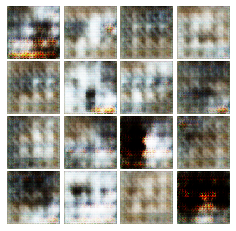


Iter: 6250, D: 0.2766, G:0.1739


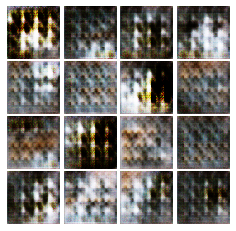


EPOCH:  14
Iter: 6500, D: 0.3463, G:0.2375


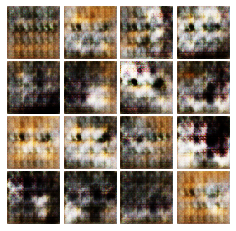


Iter: 6750, D: 0.2325, G:0.2969


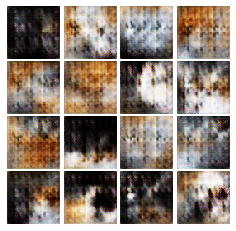


EPOCH:  15
Iter: 7000, D: 0.2307, G:0.2824


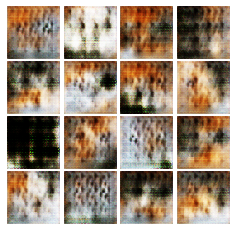


Iter: 7250, D: 0.3769, G:0.263


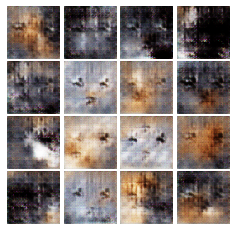


EPOCH:  16
Iter: 7500, D: 0.3626, G:0.2326


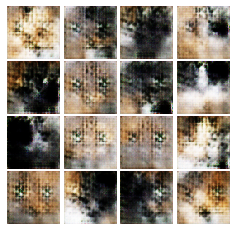


Iter: 7750, D: 0.3888, G:0.238


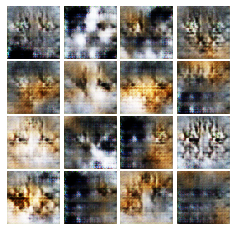


EPOCH:  17
Iter: 8000, D: 0.2506, G:0.1577


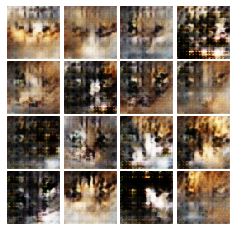


Iter: 8250, D: 0.214, G:0.2183


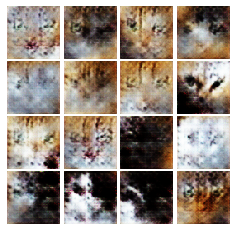


EPOCH:  18
Iter: 8500, D: 0.2369, G:0.2611


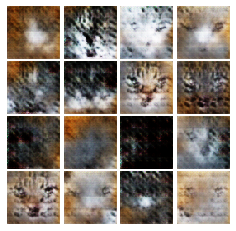


Iter: 8750, D: 0.2687, G:0.2189


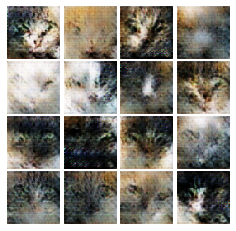


EPOCH:  19
Iter: 9000, D: 0.2368, G:0.1419


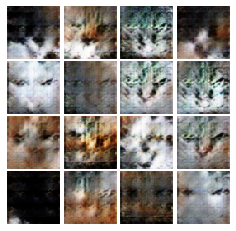


Iter: 9250, D: 0.248, G:0.1869


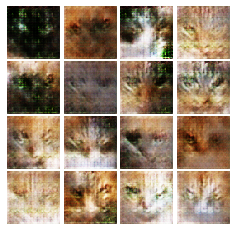


EPOCH:  20
Iter: 9500, D: 0.3337, G:0.1609


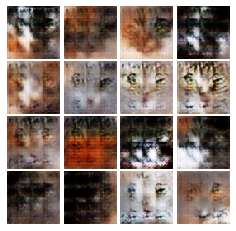


Iter: 9750, D: 0.2329, G:0.263


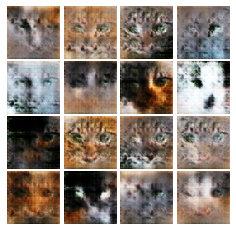


EPOCH:  21
Iter: 10000, D: 0.2173, G:0.3415


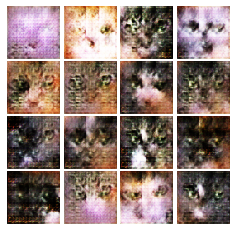


Iter: 10250, D: 0.2755, G:0.1208


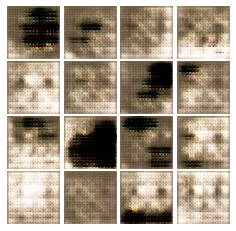


EPOCH:  22
Iter: 10500, D: 0.2897, G:0.1088


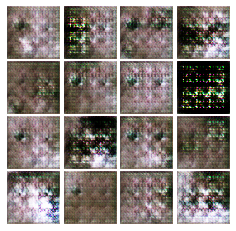


Iter: 10750, D: 0.2564, G:0.1732


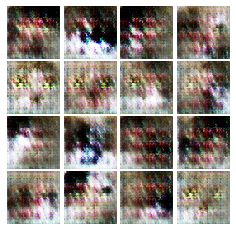


EPOCH:  23
Iter: 11000, D: 0.4103, G:0.07724


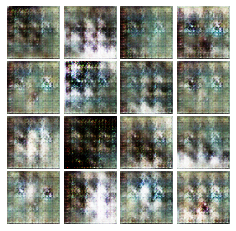


Iter: 11250, D: 0.275, G:0.1616


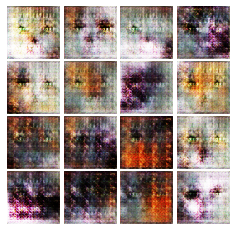


EPOCH:  24
Iter: 11500, D: 0.3069, G:0.2154


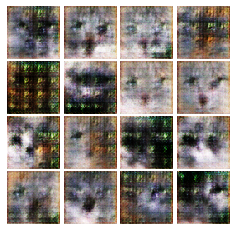


Iter: 11750, D: 0.3437, G:0.1293


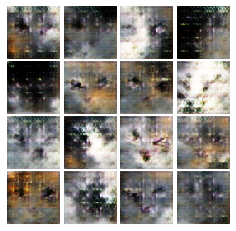


EPOCH:  25
Iter: 12000, D: 0.2939, G:0.1282


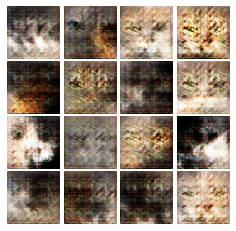


Iter: 12250, D: 0.2886, G:0.1571


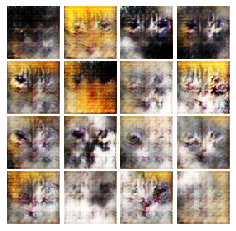


EPOCH:  26
Iter: 12500, D: 0.2876, G:0.1183


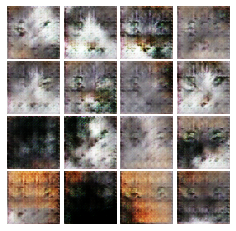


Iter: 12750, D: 0.3601, G:0.09023


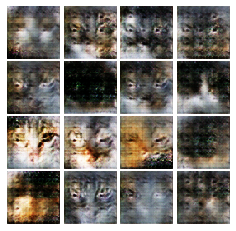


EPOCH:  27
Iter: 13000, D: 0.2822, G:0.2122


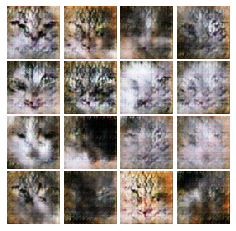


Iter: 13250, D: 0.2343, G:0.2281


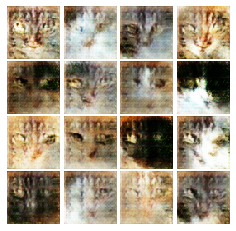


EPOCH:  28
Iter: 13500, D: 0.2467, G:0.198


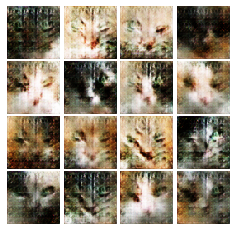


Iter: 13750, D: 0.2366, G:0.2573


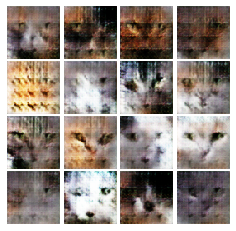


EPOCH:  29
Iter: 14000, D: 0.2593, G:0.2417


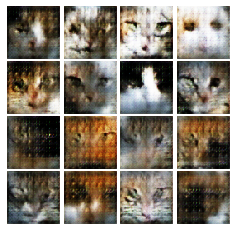


Iter: 14250, D: 0.2479, G:0.1288


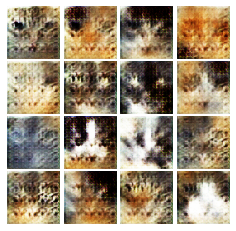


EPOCH:  30
Iter: 14500, D: 0.2286, G:0.2474


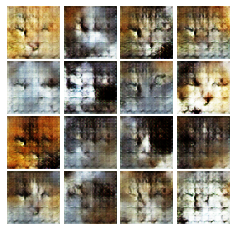


Iter: 14750, D: 0.252, G:0.2791


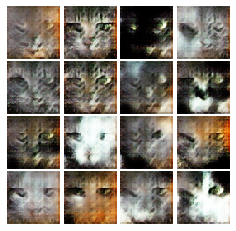


EPOCH:  31
Iter: 15000, D: 0.34, G:0.2595


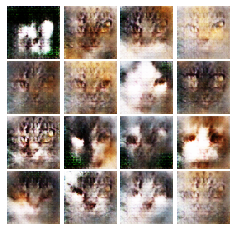


Iter: 15250, D: 0.2911, G:0.2611


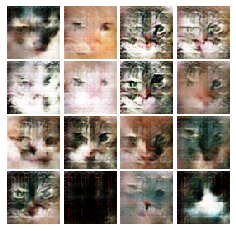


EPOCH:  32
Iter: 15500, D: 0.2394, G:0.3995


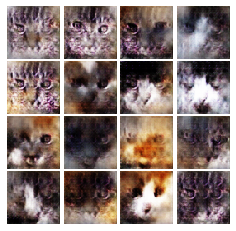


EPOCH:  33
Iter: 15750, D: 0.1884, G:0.322


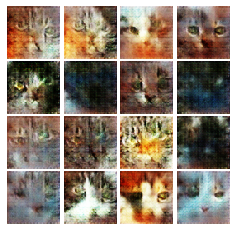


Iter: 16000, D: 0.1825, G:0.3659


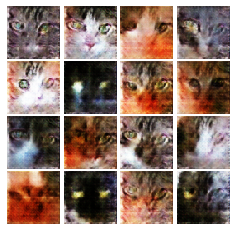


EPOCH:  34
Iter: 16250, D: 0.2193, G:0.3928


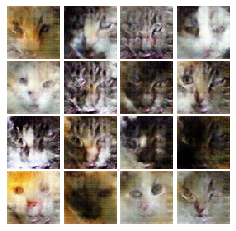


Iter: 16500, D: 0.2343, G:0.4818


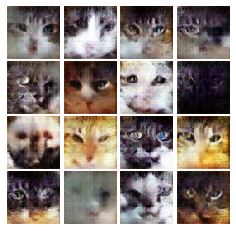


EPOCH:  35
Iter: 16750, D: 0.1806, G:0.3659


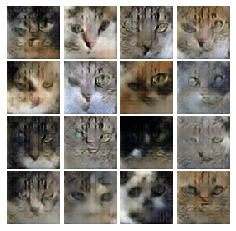


Iter: 17000, D: 0.1716, G:0.3116


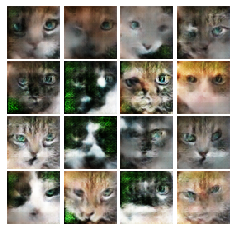


EPOCH:  36
Iter: 17250, D: 0.1694, G:0.2161


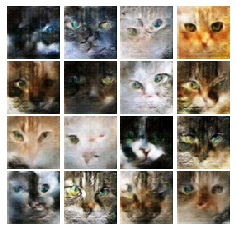


Iter: 17500, D: 0.2736, G:0.1844


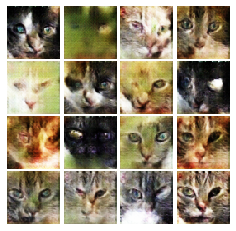


EPOCH:  37
Iter: 17750, D: 0.2417, G:0.2375


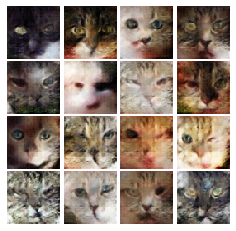


Iter: 18000, D: 0.2103, G:0.4546


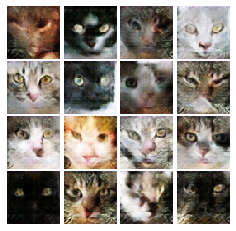


EPOCH:  38
Iter: 18250, D: 0.2705, G:0.6093


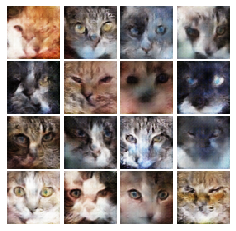


Iter: 18500, D: 0.2464, G:0.2248


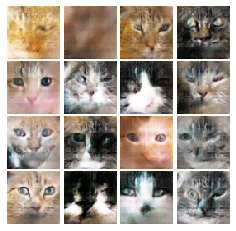


EPOCH:  39
Iter: 18750, D: 0.2162, G:0.3193


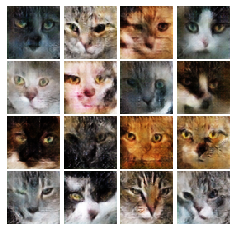


Iter: 19000, D: 0.2483, G:0.4271


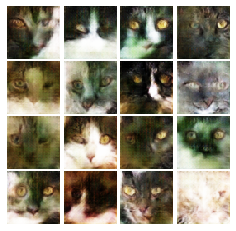


EPOCH:  40
Iter: 19250, D: 0.1389, G:0.4281


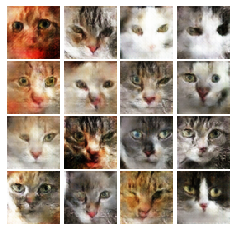


Iter: 19500, D: 0.2172, G:0.2514


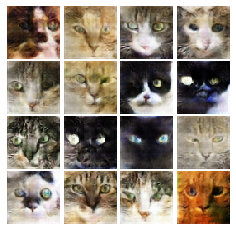


EPOCH:  41
Iter: 19750, D: 0.2152, G:0.56


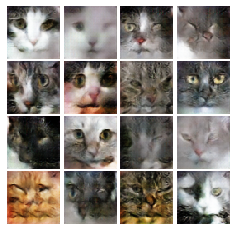


Iter: 20000, D: 0.2168, G:0.374


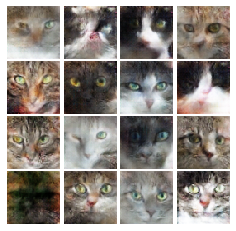


EPOCH:  42
Iter: 20250, D: 0.1644, G:0.3182


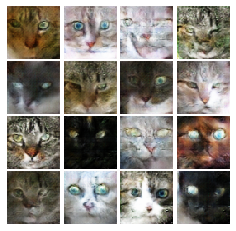


Iter: 20500, D: 0.1889, G:0.307


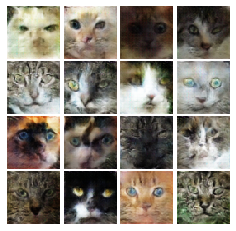


EPOCH:  43
Iter: 20750, D: 0.1492, G:0.2915


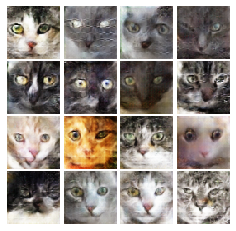


Iter: 21000, D: 0.1517, G:0.2337


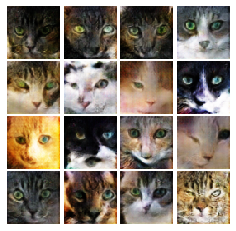


EPOCH:  44
Iter: 21250, D: 0.1788, G:0.5253


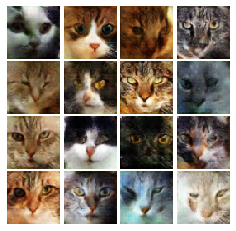


Iter: 21500, D: 0.1604, G:0.3086


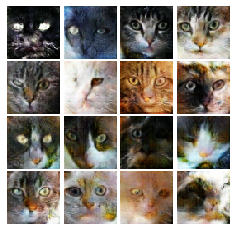


EPOCH:  45
Iter: 21750, D: 0.1016, G:0.3559


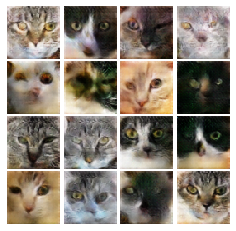


Iter: 22000, D: 0.1386, G:0.2662


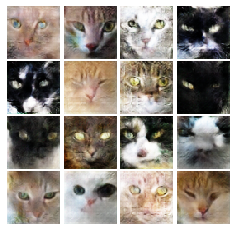


EPOCH:  46
Iter: 22250, D: 0.07414, G:0.6716


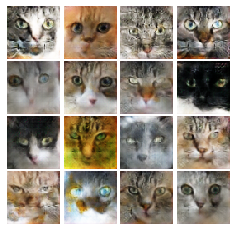


Iter: 22500, D: 0.08624, G:0.666


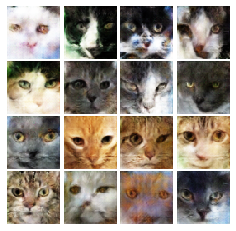


EPOCH:  47
Iter: 22750, D: 0.07403, G:0.4578


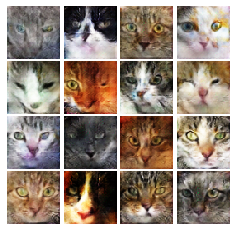


Iter: 23000, D: 0.2766, G:0.2689


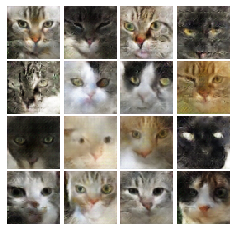


EPOCH:  48
Iter: 23250, D: 0.1653, G:0.2691


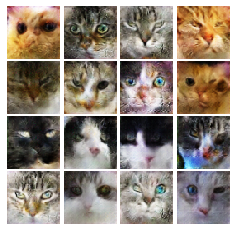


Iter: 23500, D: 0.1299, G:0.316


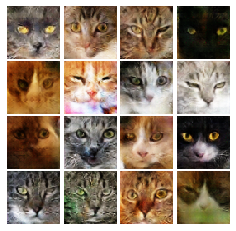


EPOCH:  49
Iter: 23750, D: 0.1399, G:0.7287


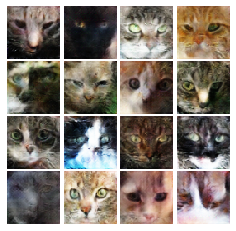


Iter: 24000, D: 0.06225, G:0.5734


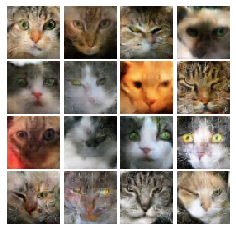


EPOCH:  50
Iter: 24250, D: 0.1126, G:0.3441


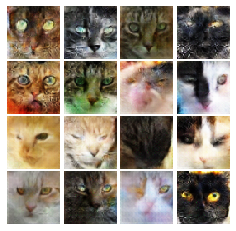


Iter: 24500, D: 0.1544, G:0.393


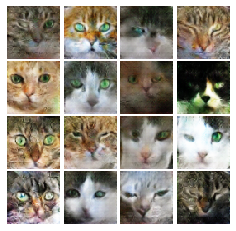

In [ ]:
# ls-gan
#  change the train() method a little bit to fit the input dimension. noise_size
train(D, G, D_optimizer, G_optimizer, ls_discriminator_loss, 
          ls_generator_loss, num_epochs=NUM_EPOCHS, show_every=250,
          batch_size=batch_size, train_loader=cat_loader_train, device=device)

In [ ]:
!wget -nc https://raw.githubusercontent.com/brpy/colab-pdf/master/colab_pdf.py
from colab_pdf import colab_pdf
colab_pdf('/content/drive/MyDrive/Colab Notebooks/GANs/MP4_sn.ipynb')

File ‘colab_pdf.py’ already there; not retrieving.





Extracting templates from packages: 100%
